In [1]:
import numpy as np
import os
import os.path as osp
import argparse
from tqdm import tqdm
import librosa


In [2]:

Config ={}
Config['root_path'] = '/Users/tieming/code/dataset/train'
Config['english'] = osp.join(Config['root_path'], 'train_english')
Config['hindi'] = osp.join(Config['root_path'], 'train_hindi')
Config['mandarin'] = osp.join(Config['root_path'], 'train_mandarin')
Config['mfcc_feature'] = 64


# Experiment

In [3]:

english_ex = osp.join(Config['english'], "english_0001.wav")
y, sr = librosa.load(english_ex, sr=16000)
y = librosa.core.to_mono(y)
mat = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=64, n_fft=int(sr*0.025), hop_length= int ( sr *0.010) )
print(y.shape, sr, mat.shape)

(10235681,) 16000 (64, 63974)


In [23]:
seconds_ex = y.shape[0] // 16000
print(seconds_ex, "seconds")

print(mat.shape[1], "frames in 10 ms (M)")

639 seconds
63974 frames in 10 ms (M)


In [24]:
S=librosa.stft(y,n_fft=int(sr*0.025),hop_length= int(sr*0.010))
D=librosa.amplitude_to_db(np.abs(S),ref=np.max)
print("Max dB in audio:")
np.max(np.abs(D))

Max dB in audio:


80.0

### raw audio file

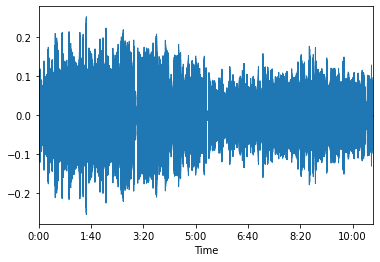

In [35]:
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display

# y_db = librosa.amplitude_to_db(np.abs(y[:100000]))
plt.figure()
librosa.display.waveplot(y, sr=sr)

### split silence

(7818240,)


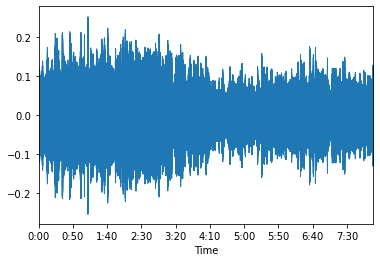

In [40]:
intervals = librosa.effects.split(y, top_db=40)
y_cons = np.zeros((0,))
for interval in intervals:
    y_cons = np.hstack([y_cons, y[interval[0]:interval[1]] ])
print(y_cons.shape)
plt.figure()
librosa.display.waveplot(y_cons, sr=sr)

[Text(0.5, 1.0, 'MFCC')]

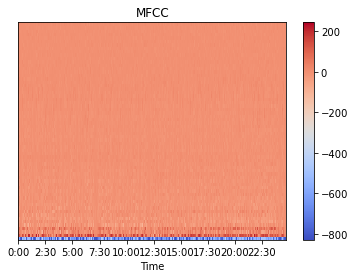

In [17]:
fig, ax = plt.subplots()
img = librosa.display.specshow(mat, x_axis='time', ax=ax)
fig.colorbar(img, ax=ax)
ax.set(title='MFCC')

/opt/anaconda3/envs/ee599/lib/python3.7/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'basey' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
/opt/anaconda3/envs/ee599/lib/python3.7/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'linthreshy' parameter of __init__() has been renamed 'linthresh' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)


[Text(0.5, 1.0, 'Mel-frequency spectrogram')]

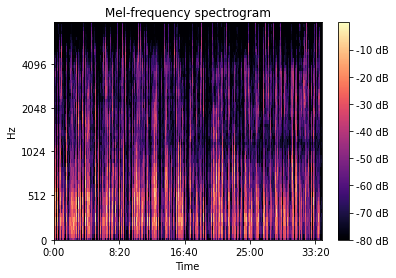

In [18]:
fig, ax = plt.subplots()
mel_S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=64,n_fft=int(sr*0.025), hop_length= int ( sr *0.010) )
S_dB = librosa.power_to_db(mel_S, ref=np.max)
img = librosa.display.specshow(S_dB, x_axis='time',
                         y_axis='mel', sr=sr,
                         fmax=8000, ax=ax)
fig.colorbar(img, ax=ax, format='%+2.0f dB')
ax.set(title='Mel-frequency spectrogram')

In [6]:
import IPython.display as ipd
# listen to a sample
ipd.Audio(english_ex, rate=sr)

# Preprocessing

In [3]:
# 64-dimensional MFCC features in this HW
num_feature = Config['mfcc_feature']

english_list = os.listdir(Config['english'])
hindi_list = os.listdir(Config['hindi'])
mandarin_list = os.listdir(Config['mandarin'])


In [5]:

def mel_features(filename, thres=40):
    '''
    @param thres: The threshold (in decibels) below reference to consider as silence
    @return mfccs: np.ndarray, shape=(num_features,n_mfcc)
    '''
    y, sr = librosa.load(filename, sr=16000)
    y = librosa.core.to_mono(y)
    intervals = librosa.effects.split(y, top_db=thres)
    
    y_cons = np.zeros((0,))
    for interval in intervals:
        y_cons = np.hstack([ y_cons, y[interval[0]: interval[1]] ])
        
    mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=64, n_fft=int(sr*0.025), hop_length= int ( sr *0.010) )
    return mfccs.T

    
# change it into in place!
english_mfcc = []
for filename in tqdm(english_list):
    mfccs = mel_features(osp.join(Config['english'], filename), thres=40)    
    english_mfcc.append(mfccs)
english_mfcc = np.array(english_mfcc)


 23%|██▎       | 37/164 [03:03<14:05,  6.65s/it]/opt/anaconda3/envs/ee599/lib/python3.7/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
100%|██████████| 164/164 [17:35<00:00,  6.44s/it]

(164,)



/opt/anaconda3/envs/ee599/lib/python3.7/site-packages/ipykernel_launcher.py:24: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


In [22]:
english_2D = np.concatenate([x for x in english_mfcc])

In [23]:
english_2D.shape

(10328428, 64)

In [24]:
mapping = {'english':0,'hindi':1,'mandarin':2}

In [25]:
# extract music in 8 seconds
# (M, 64) => (N, S, 64) where M = N * S

sequence_length = 801


N_english = english_2D.shape[0] // sequence_length
# make sure that I can utilize reshape
english_2D = english_2D[:N_english*sequence_length]
english_3D = english_2D.reshape((N_english, sequence_length, 64))

english_label = np.full(shape=(N_english,sequence_length,1),fill_value=mapping['english'])

english_all = np.concatenate([english_3D, english_label],axis=2)
print("English data shape:",english_all.shape)

English data shape: (12910, 800, 65)


In [31]:
extract_label = english_all[:,:,-1]
print(extract_label.shape)

extract_data = english_all[:,:,:64]
print(extract_data.shape)

(12910, 800)
(12910, 800, 64)


In [32]:
def processing(language_list=mandarin_list, language="mandarin"):
    language_mfcc = []
    for filename in tqdm(language_list):
        mfccs = mel_features(osp.join(Config[language], filename), thres=40)    
        language_mfcc.append(mfccs)
    language_mfcc = np.array(language_mfcc)

    language_2D = np.concatenate([x for x in language_mfcc])
    N_lan = language_2D.shape[0] // sequence_length
    # make sure that I can utilize reshape
    language_2D = language_2D[:N_lan*sequence_length]
    language_3D = language_2D.reshape((N_lan, sequence_length, 64))

    lan_label = np.full(shape=(N_lan,sequence_length,1),fill_value=mapping[language])

    lan_all = np.concatenate([language_3D, lan_label],axis=2)
    return lan_all

In [33]:
mandarin_all = processing(language_list=mandarin_list, language="mandarin")

 72%|███████▏  | 79/110 [07:09<03:22,  6.54s/it]/opt/anaconda3/envs/ee599/lib/python3.7/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
100%|██████████| 110/110 [10:56<00:00,  5.96s/it]
/opt/anaconda3/envs/ee599/lib/python3.7/site-packages/ipykernel_launcher.py:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  


In [56]:
hindi_all = processing(language_list=hindi_list, language="hindi")

100%|██████████| 41/41 [06:32<00:00,  9.57s/it]
/opt/anaconda3/envs/ee599/lib/python3.7/site-packages/ipykernel_launcher.py:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  


In [57]:
X_all = np.concatenate([english_all, mandarin_all, hindi_all],axis=0)
print(X_all.shape)


(25147, 800, 65)


In [60]:
from sklearn.model_selection import train_test_split
import h5py

train_all, test_all = train_test_split(X_all, test_size=0.1, random_state=11)
print(train_all.shape, test_all.shape)


(22632, 800, 65) (2515, 800, 65)


In [61]:
train_label = train_all[:,:,-1]

train_data = train_all[:,:,:64]

test_label = test_all[:,:,-1]

test_data = test_all[:,:,:64]

In [65]:
test_data.shape

(2515, 800, 64)

In [66]:
with h5py.File(osp.join(Config['root_path'], "hw5_data.hdf5") , 'w') as hf:
    hf.create_dataset('train_data', data=train_data)
    hf.create_dataset('train_label', data=train_label)
    hf.create_dataset('test_data', data=test_data)
    hf.create_dataset('test_label', data=test_label) 

TODO: set label into 3 dimensions 

TODO: separate training and testing data into different speaker
